In [2]:
from azure.cognitiveservices.vision.computervision import ComputerVisionClient
from azure.cognitiveservices.vision.computervision.models import OperationStatusCodes, \
    ComputerVisionErrorResponseException
from azure.cognitiveservices.vision.computervision.models import VisualFeatureTypes
from azure.ai.vision.imageanalysis.models import VisualFeatures
from msrest.authentication import CognitiveServicesCredentials
from array import array
import os
from PIL import Image
import sys
import time
import matplotlib.pyplot as plt
from skimage import io
import numpy as np 

from azure.cognitiveservices.vision.computervision.models import OperationStatusCodes
from azure.cognitiveservices.vision.computervision.models import VisualFeatureTypes
from azure.ai.vision.imageanalysis.models import VisualFeatures
import os
from matplotlib import patches
from azure.cognitiveservices.vision.computervision import ComputerVisionClient


subscription_key = os.environ["VISION_KEY"]
endpoint = os.environ["VISION_ENDPOINT"]
computervision_client = ComputerVisionClient(endpoint, CognitiveServicesCredentials(subscription_key))
from PIL import Image


In [10]:
def evalClassificationV1(realLabels, computedLabels, labelNames):
    from sklearn.metrics import confusion_matrix, accuracy_score, precision_score, recall_score

    cm = confusion_matrix(realLabels, computedLabels, labels=labelNames)
    acc = accuracy_score(realLabels, computedLabels)
    precision = precision_score(realLabels, computedLabels, average=None, labels=labelNames)
    recall = recall_score(realLabels, computedLabels, average=None, labels=labelNames)
    return acc, precision, recall


Clasificarea binara


In [9]:
def is_bird(image_path): 
       with open(image_path, "rb") as image_stream:
        result = computervision_client.analyze_image_in_stream(
            image_stream,
            visual_features=[VisualFeatureTypes.tags]
        )
        tags = [tag.name.lower() for tag in result.tags]
        
        if any(tag in tags for tag in ['bird', 'duck']):
            return 1
        return 0
       

In [7]:
def prediction(folder_path):
    predicted = []
    birds = []

    for filename in os.listdir(folder_path):
        file_path = os.path.join(folder_path, filename)

        while True: 
            try:
                with open(file_path, "rb") as img_file:
                    result = computervision_client.analyze_image_in_stream(
                        img_file,
                        visual_features=[VisualFeatureTypes.tags]
                    )
                break  

            except ComputerVisionErrorResponseException as e:
                if e.response.status_code == 429:
                    print(f"[{filename}] Rate limit hit. Waiting 35 seconds...")
                    time.sleep(35)
                else:
                    print(f"[{filename}] Azure error: {e}")
                    result = None
                    break
            except Exception as e:
                print(f"[{filename}] Unexpected error: {e}")
                result = None
                break

        if result:
            found = False
            for tag in result.tags:
                if ("bird" in tag.name.lower()) or ("duck" in tag.name.lower()):
                    predicted.append('bird')
                    birds.append(filename)
                    found = True
                    break

            if not found:
                predicted.append('no-bird')

    return predicted, birds


In [12]:
folder_path = 'duck_images'
predictions, birds = prediction(folder_path) 
ground_truth=['bird','no-bird','no-bird','bird','bird','bird','bird','bird','bird','no-bird','no-bird','bird','bird','no-bird','no-bird','no-bird','bird','no-bird','bird','bird']
accuracy, precision, recall = evalClassificationV1(ground_truth, predictions, ['bird','no-bird'])
print(ground_truth)
print(predictions)
print(f"Accuracy: {accuracy}, Precision: {precision}, Recall: {recall}")


['bird', 'no-bird', 'no-bird', 'bird', 'bird', 'bird', 'bird', 'bird', 'bird', 'no-bird', 'no-bird', 'bird', 'bird', 'no-bird', 'no-bird', 'no-bird', 'bird', 'no-bird', 'bird', 'bird']
['bird', 'no-bird', 'no-bird', 'bird', 'bird', 'bird', 'bird', 'bird', 'no-bird', 'no-bird', 'no-bird', 'bird', 'bird', 'no-bird', 'no-bird', 'no-bird', 'bird', 'no-bird', 'bird', 'bird']
Accuracy: 0.95, Precision: [1.         0.88888889], Recall: [0.91666667 1.        ]


In [13]:
def compute_iou(boxA, boxB):
    if boxA is None or boxB is None:
        return 0

    xA = max(boxA[0], boxB[0])
    yA = max(boxA[1], boxB[1])
    xB = min(boxA[2], boxB[2])
    yB = min(boxA[3], boxB[3])

    inter_width = max(0, xB - xA)
    inter_height = max(0, yB - yA)
    inter_area = inter_width * inter_height

    boxA_area = (boxA[2] - boxA[0]) * (boxA[3] - boxA[1])
    boxB_area = (boxB[2] - boxB[0]) * (boxB[3] - boxB[1])

    union_area = boxA_area + boxB_area - inter_area

    iou = inter_area / union_area if union_area > 0 else 0
    return iou

In [14]:
manual_boxes = {
    "back_duck.jpeg": [[592, 586, 1073, 1359]],
    "duck_above.jpeg": [[257, 841, 860, 1441], [284, 414, 765, 814]],
    "duck_another_above.jpeg": [[316, 473, 821, 835], [243, 881, 981, 1311]],
    "duck_fence.jpeg": [[205, 662, 589, 1057], [632, 662, 1108, 892]],
    "duck_normal.jpeg": [[27, 543, 913, 1397], [724, 641, 1097, 1322]],
    "duck_other.jpeg": [[22, 30, 944, 814], [849, 251, 1195, 751]],
    "duck_water.jpeg": [[659, 152, 928, 417], [5, 137, 416, 406]],
    "only_mac.jpeg": [[81, 45, 998, 775]],
    "pam.jpeg": [[145, 716, 1287, 1487]],
    "seagul.jpeg": [[89, 211, 532, 762]],
    "the_three.jpeg": [[254, 832, 562, 1008], [830, 889, 1100, 1070]],
    "water_duck.jpeg": [[386, 759, 837, 1110]]
}

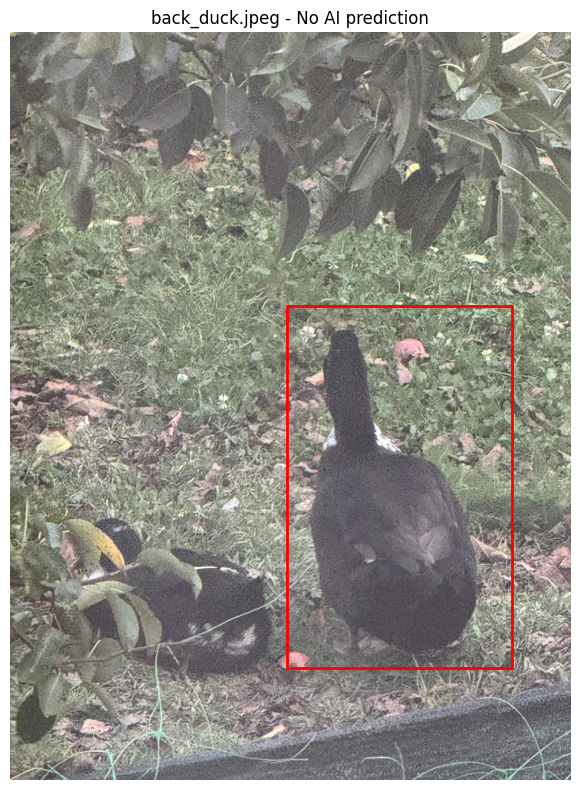

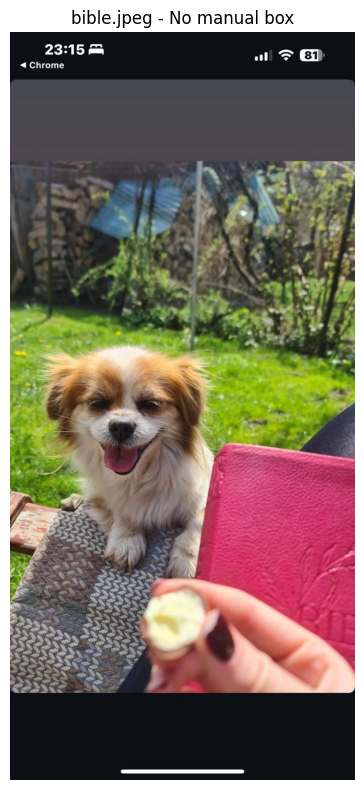

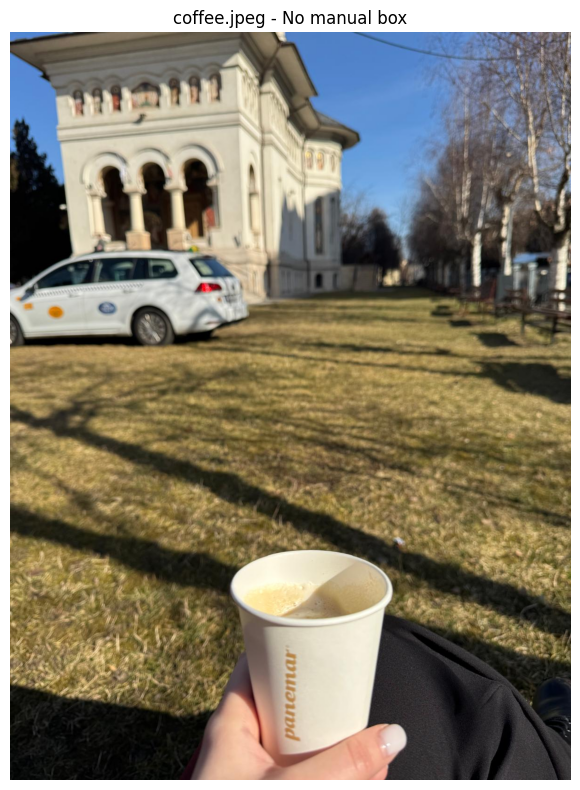

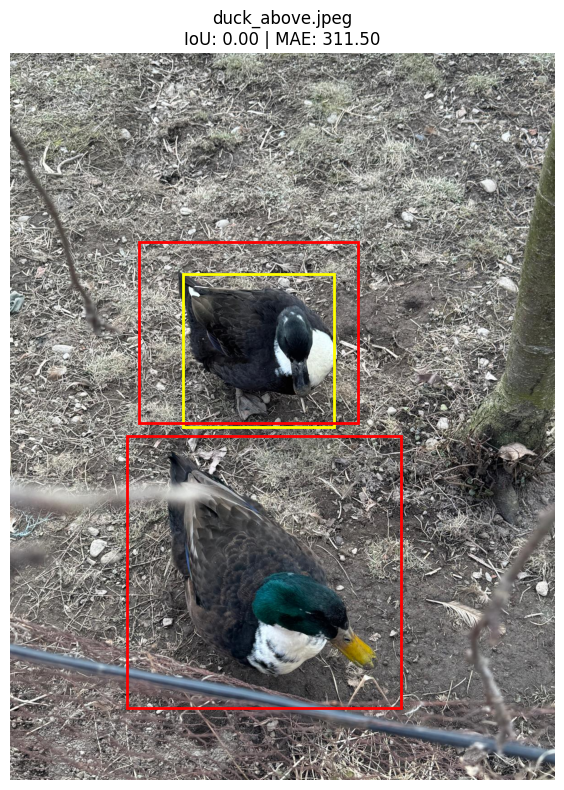

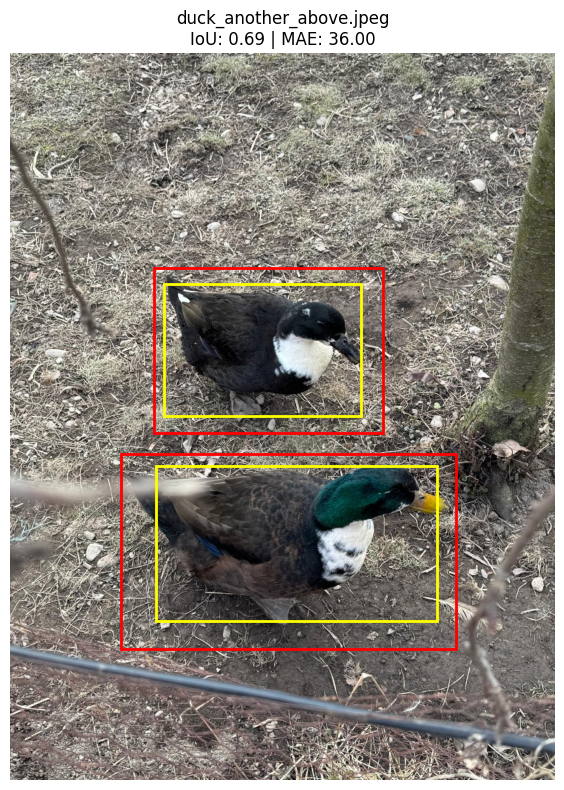

...

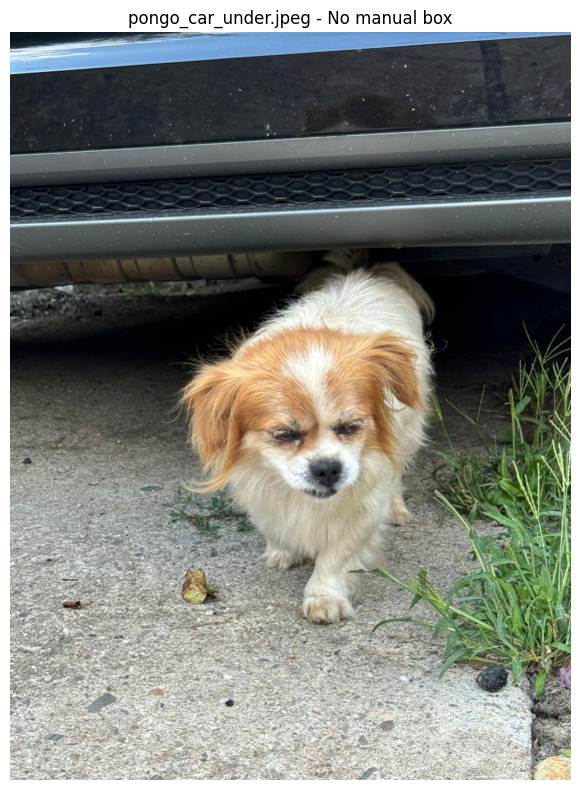

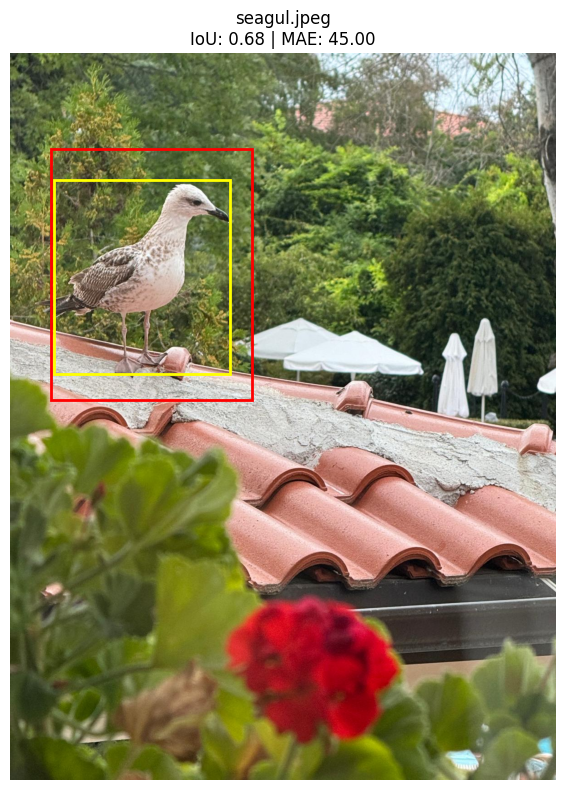

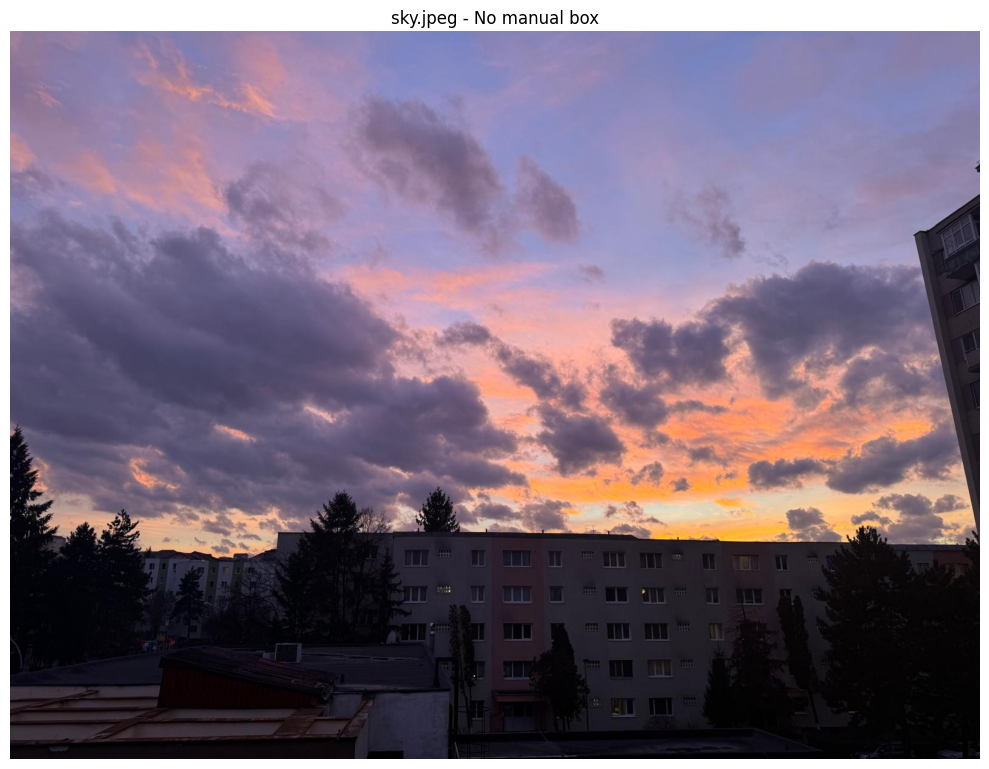

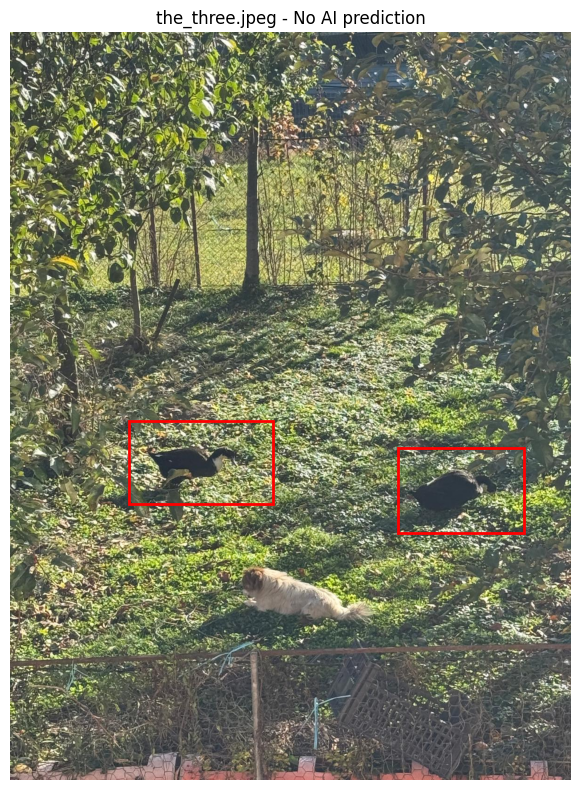

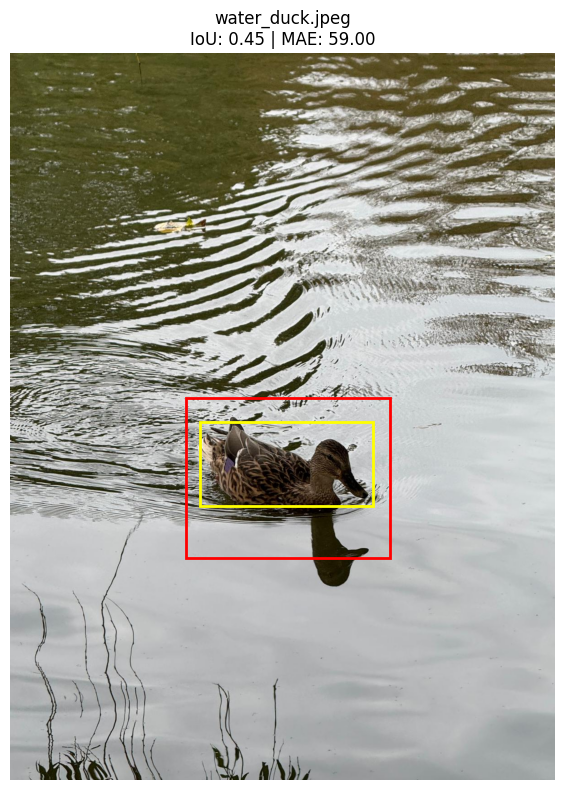


 Accuracy@IoU>=0.5: 0.56
 Mean IoU: 0.459
 Mean MAE: 139.03


In [15]:
import statistics

folder_path = "duck_images"
threshold = 0.5
ious = []
maes = []
correct = 0
evaluated = 0

for filename in os.listdir(folder_path):
    image_path = os.path.join(folder_path, filename)

    try:
        im = Image.open(image_path).convert("RGB")

        with open(image_path, "rb") as img_file:
            result = computervision_client.analyze_image_in_stream(
                img_file,
                visual_features=[VisualFeatureTypes.objects]
            )

        ai_boxes = []
        for obj in result.objects:
            if obj.object_property.lower() in ["bird", "duck"]:
                bb = [
                    obj.rectangle.x,
                    obj.rectangle.y,
                    obj.rectangle.x + obj.rectangle.w,
                    obj.rectangle.y + obj.rectangle.h
                ]
                ai_boxes.append(bb)

        fig, ax = plt.subplots(figsize=(10, 8))
        ax.imshow(im)

        for bb in ai_boxes:
            rect = patches.Rectangle(
                (bb[0], bb[1]), bb[2] - bb[0], bb[3] - bb[1],
                linewidth=2, edgecolor="yellow", facecolor="none", label="AI"
            )
            ax.add_patch(rect)

        if filename in manual_boxes:
            for real_box in manual_boxes[filename]:
                rect = patches.Rectangle(
                    (real_box[0], real_box[1]), real_box[2] - real_box[0], real_box[3] - real_box[1],
                    linewidth=2, edgecolor="red", facecolor="none", label="Manual"
                )
                ax.add_patch(rect)

            if ai_boxes:
                predicted_box = ai_boxes[0]
                manual_box = manual_boxes[filename][0]

                iou = compute_iou(predicted_box, manual_box)
                ious.append(iou)

                mae = sum([abs(a - b) for a, b in zip(predicted_box, manual_box)]) / 4
                maes.append(mae)

                if iou >= threshold:
                    correct += 1
                evaluated += 1

                ax.set_title(f"{filename}\nIoU: {iou:.2f} | MAE: {mae:.2f}", fontsize=12)
            else:
                ax.set_title(f"{filename} - No AI prediction", fontsize=12)

        else:
            ax.set_title(f"{filename} - No manual box", fontsize=12)
        ax.axis("off")
        plt.tight_layout()
        plt.show()

    except Exception as e:
        print(f" Error on {filename}: {e}")

acc = correct / evaluated
mean_iou = statistics.mean(ious)
mean_mae = statistics.mean(maes)
print(f"\n Accuracy@IoU>={threshold}: {acc:.2f}")
print(f" Mean IoU: {mean_iou:.3f}")
print(f" Mean MAE: {mean_mae:.2f}")


Acuratetea - rezultat decent 
Mean - obiectul se colizeaza dar mai slab decat localizarea manuala
MAE - cu 139 de pixeli diferenta - ma gandesc deoarece exista pasari pe care nu le vede
